## Importing the necessary modules

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import warnings as w
w.filterwarnings('ignore')

## Importing the Dataset

In [2]:
df = pd.read_csv("globalterrorism.csv",encoding='ISO-8859-1')
df.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


## Filtering out the necessary columns

In [3]:
columns = [
    'iyear', 'imonth', 'iday', 'extended', 'country_txt', 'region_txt',
    'city', 'latitude', 'longitude', 'specificity', 'summary', 'success', 'suicide',
    'attacktype1_txt', 'targtype1_txt', 'corp1', 'target1', 'natlty1_txt', 'gname',
    'nperps', 'weaptype1_txt', 'nkill', 'nkillter', 'nwound', 'nwoundte',
    'ishostkid'
]
df = df.loc[:,columns]

In [4]:
df.head()

,iyear,imonth,iday,extended,country_txt,region_txt,city,latitude,longitude,specificity,...,target1,natlty1_txt,gname,nperps,weaptype1_txt,nkill,nkillter,nwound,nwoundte,ishostkid
0,1970,7,2,0,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,1.0,...,Julio Guzman,Dominican Republic,MANO-D,NaN,Unknown,1.0,NaN,0.0,NaN,0.0
1,1970,0,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,1.0,...,"Nadine Chaval, daughter",Belgium,23rd of September Communist League,7.0,Unknown,0.0,NaN,0.0,NaN,1.0
2,1970,1,0,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,4.0,...,Employee,United States,Unknown,NaN,Unknown,1.0,NaN,0.0,NaN,0.0
3,1970,1,0,0,Greece,Western Europe,Athens,37.997490,23.762728,1.0,...,U.S. Embassy,United States,Unknown,NaN,Explosives,NaN,NaN,NaN,NaN,0.0
4,1970,1,0,0,Japan,East Asia,Fukouka,33.580412,130.396361,1.0,...,U.S. Consulate,United States,Unknown,NaN,Incendiary,NaN,NaN,NaN,NaN,0.0


In [5]:
df.shape

(181691, 26)

## Percentage of null values in each columns

In [6]:
df.isnull().sum()/df.shape[0] * 100

iyear               0.000000
imonth              0.000000
iday                0.000000
extended            0.000000
country_txt         0.000000
region_txt          0.000000
city                0.238867
latitude            2.507554
longitude           2.508104
specificity         0.003302
summary            36.396409
success             0.000000
suicide             0.000000
attacktype1_txt     0.000000
targtype1_txt       0.000000
corp1              23.418882
target1             0.350045
natlty1_txt         0.858050
gname               0.000000
nperps             39.140629
weaptype1_txt       0.000000
nkill               5.676120
nkillter           36.852678
nwound              8.977330
nwoundte           38.055270
ishostkid           0.097969
dtype: float64

## Percentage of unique values in each column

In [7]:
df.nunique() / df.shape[0] * 100

iyear               0.025868
imonth              0.007155
iday                0.017612
extended            0.001101
country_txt         0.112829
region_txt          0.006605
city               20.184819
latitude           26.595704
longitude          26.439945
specificity         0.002752
summary            61.913909
success             0.001101
suicide             0.001101
attacktype1_txt     0.004953
targtype1_txt       0.012108
corp1              18.293696
target1            47.336412
natlty1_txt         0.118333
gname               1.946712
nperps              0.062194
weaptype1_txt       0.006605
nkill               0.112829
nkillter            0.052837
nwound              0.130992
nwoundte            0.024217
ishostkid           0.001651
dtype: float64

## Exploratory Data Analysis

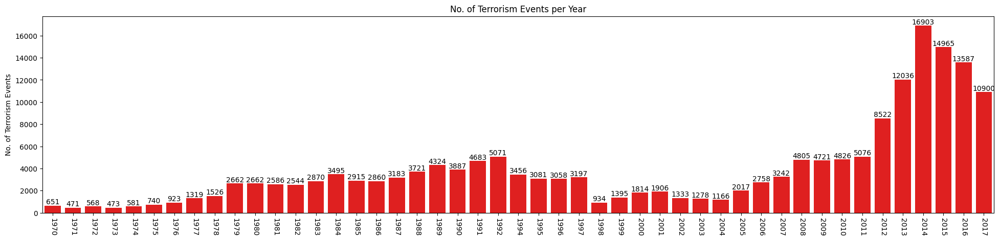

In [8]:
fig, ax = plt.subplots(figsize=(24, 5))
sns.countplot(
    data=df,
    x="iyear",
    orient='h',
    color="red",
    ax=ax 
)
for i in ax.containers:
    ax.bar_label(i,)
plt.xticks(rotation=270)
plt.xlabel(None)
plt.ylabel("No. of Terrorism Events")
plt.title("No. of Terrorism Events per Year");

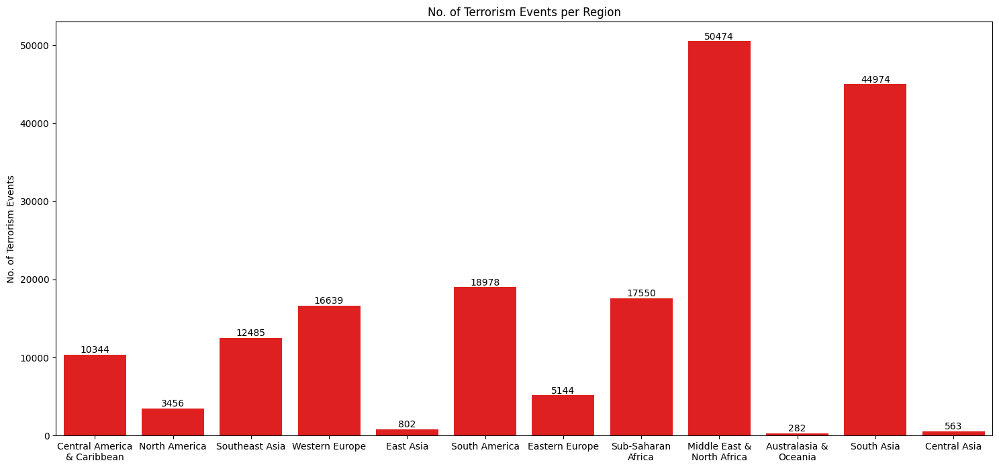

In [9]:
fig, ax = plt.subplots(figsize=(18, 8))
sns.countplot(
    data=df,
    x="region_txt",
    orient='h',
    color="red",
    ax=ax 
)

import textwrap
def wrap_labels(ax, width, break_long_words=False):
    labels = []
    for label in ax.get_xticklabels():
        text = label.get_text()
        labels.append(textwrap.fill(text, width=width,
                      break_long_words=break_long_words))
    ax.set_xticklabels(labels, rotation=0)
for i in ax.containers:
    ax.bar_label(i,)
wrap_labels(ax, 15)
plt.xlabel(None)
plt.ylabel("No. of Terrorism Events")
plt.title("No. of Terrorism Events per Region");

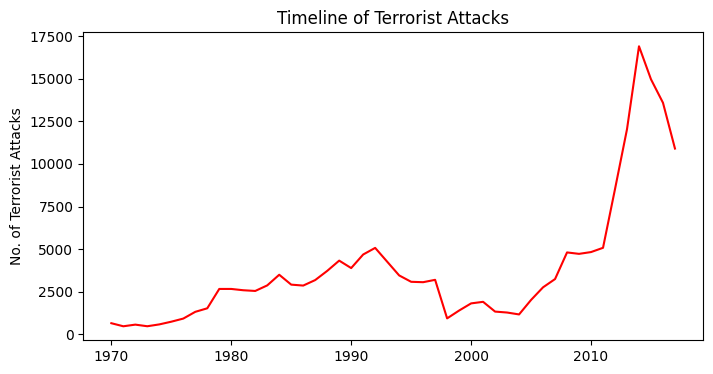

In [10]:
fig, ax = plt.subplots(figsize=(8, 4))
sns.lineplot(
    x=df["iyear"].value_counts().index,
    y=df["iyear"].value_counts().values,
    color="red",
    ax=ax 
)

plt.xlabel(None)
plt.ylabel("No. of Terrorist Attacks")
plt.title("Timeline of Terrorist Attacks");

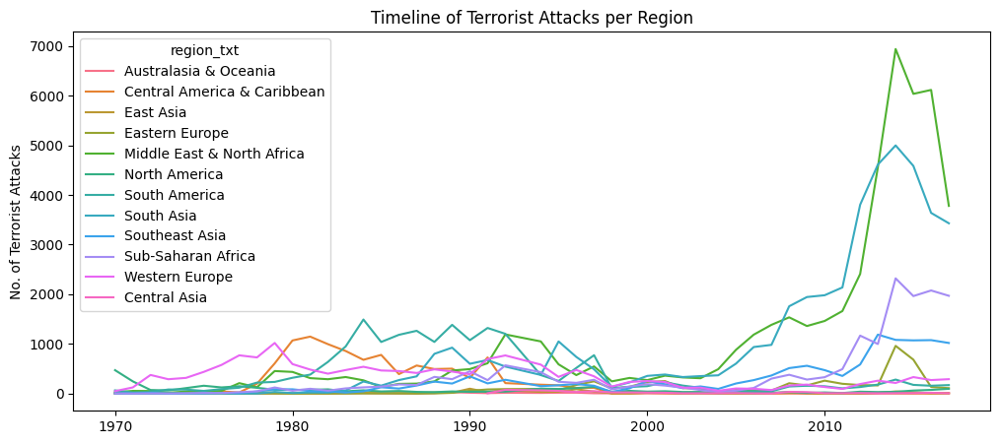

In [11]:
df_reg_year = df.groupby(['iyear', 'region_txt']).size().reset_index(name='count')

fig, ax = plt.subplots(figsize=(12, 5))
sns.lineplot(
    x="iyear",
    y="count",
    hue="region_txt",
    data=df_reg_year,
    ax=ax 
)

plt.xlabel(None)
plt.ylabel("No. of Terrorist Attacks")
plt.title("Timeline of Terrorist Attacks per Region");

In [12]:
import textwrap
def wrap_labels(ax, width, break_long_words=False):
    labels = []
    for label in ax.get_xticklabels():
        text = label.get_text()
        labels.append(textwrap.fill(text, width=width,
                      break_long_words=break_long_words))
    ax.set_xticklabels(labels, rotation=0)

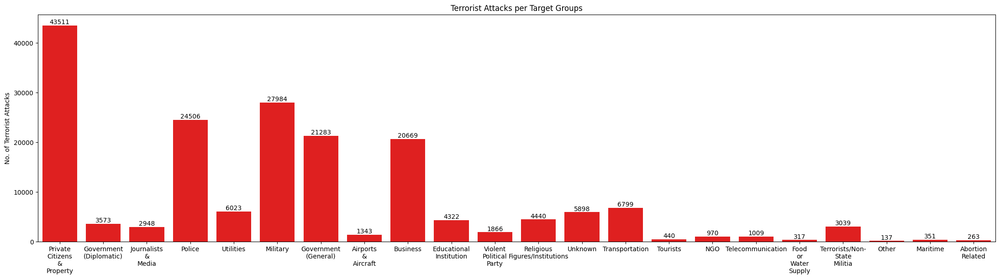

In [13]:
fig, ax = plt.subplots(figsize=(22, 6))
sns.countplot(
    data=df,
    x="targtype1_txt",
    orient='h',
    color="red",
    ax=ax,
)
for i in ax.containers:
    ax.bar_label(i,)
wrap_labels(ax, 5)
plt.xlabel(None)
plt.tight_layout()
plt.ylabel("No. of Terrorist Attacks")
plt.title("Terrorist Attacks per Target Groups");

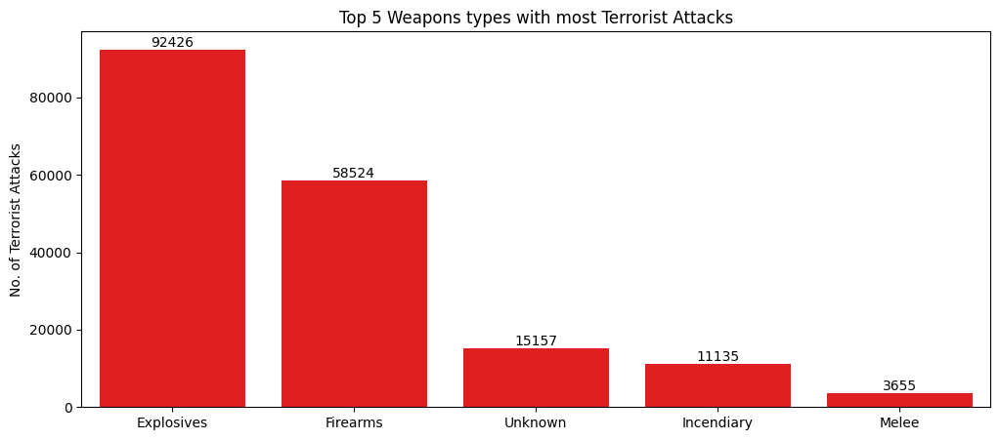

In [14]:
fig, ax = plt.subplots(figsize=(12, 5))
sns.barplot(
    x=df["weaptype1_txt"].value_counts()[:5].index,
    y=df["weaptype1_txt"].value_counts()[:5].values,
    color="red",
    ax=ax 
)
for i in ax.containers:
    ax.bar_label(i,)
wrap_labels(ax, 18)
plt.xlabel(None)
plt.ylabel("No. of Terrorist Attacks")
plt.title("Top 5 Weapons types with most Terrorist Attacks");

In [15]:
import plotly.express as px
fig = px.density_mapbox(df, lat='latitude', lon='longitude', z='specificity', radius=5,
                        center=dict(lat=20, lon=80), zoom=3, mapbox_style = 'open-street-map',
                        color_continuous_scale = 'rainbow', opacity=0.6,
                        title="Specificity of Terrorist Attacks around the World",
                        hover_data=["country_txt","specificity"])
fig.show()

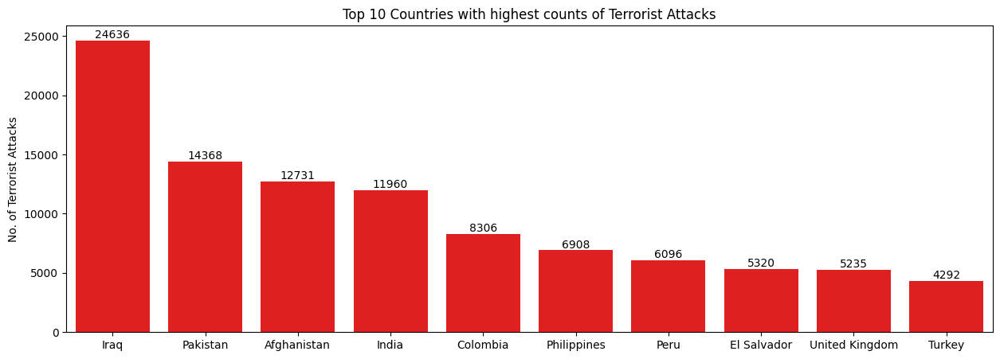

In [16]:
fig, ax = plt.subplots(figsize=(15,5))
sns.barplot(
    x=df["country_txt"].value_counts()[:10].index,
    y=df["country_txt"].value_counts()[:10].values,
    color="red",
    ax=ax 
)
wrap_labels(ax,18)
for i in ax.containers:
    ax.bar_label(i,)
plt.xlabel(None)
plt.ylabel("No. of Terrorist Attacks")
plt.title("Top 10 Countries with highest counts of Terrorist Attacks");

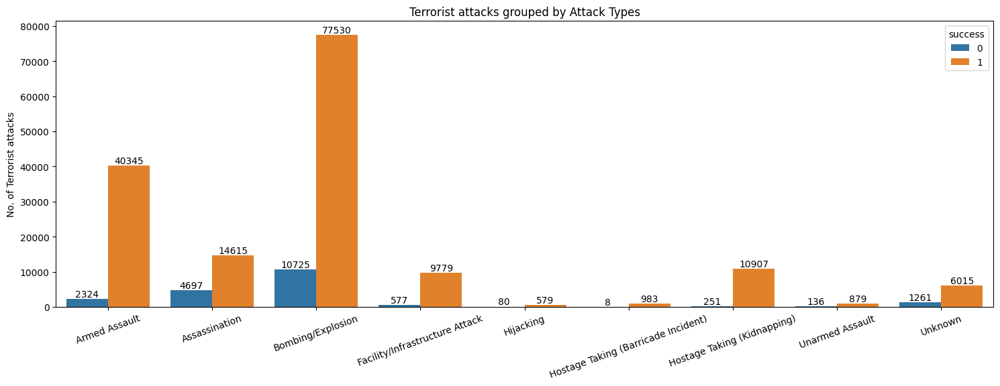

In [17]:
df_attacktype = df.groupby(['attacktype1_txt', 'success']).size().reset_index(name="count")
fig, ax = plt.subplots(figsize=(15,5))
sns.barplot(
    data=df_attacktype,
    x="attacktype1_txt",
    y="count",
    hue="success"
)
for i in ax.containers:
    ax.bar_label(i,)
plt.tight_layout()
plt.xlabel(None)
plt.title("Terrorist attacks grouped by Attack Types")
plt.ylabel("No. of Terrorist attacks")
plt.xticks(rotation=20);

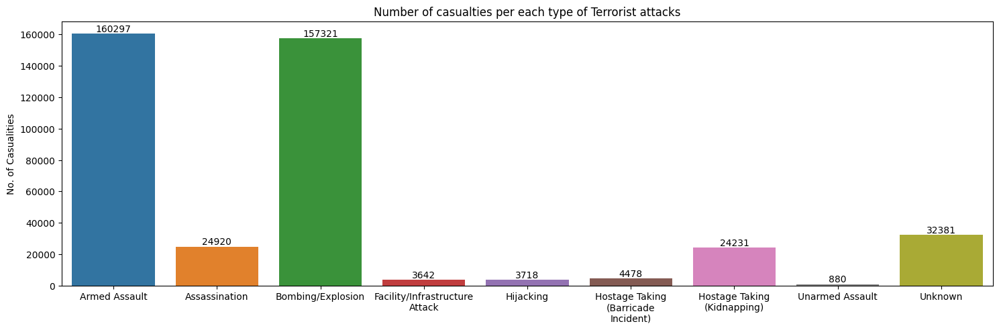

In [18]:
df_attacktype = df.groupby('attacktype1_txt')[['nkill']].sum().reset_index()
fig, ax = plt.subplots(figsize=(15,5))
sns.barplot(
    data=df_attacktype,
    x="attacktype1_txt",
    y="nkill",
)
wrap_labels(ax,18)
for i in ax.containers:
    ax.bar_label(i,)
plt.tight_layout()
plt.xlabel(None)
plt.ylabel("No. of Casualities")
plt.title("Number of casualties per each type of Terrorist attacks");

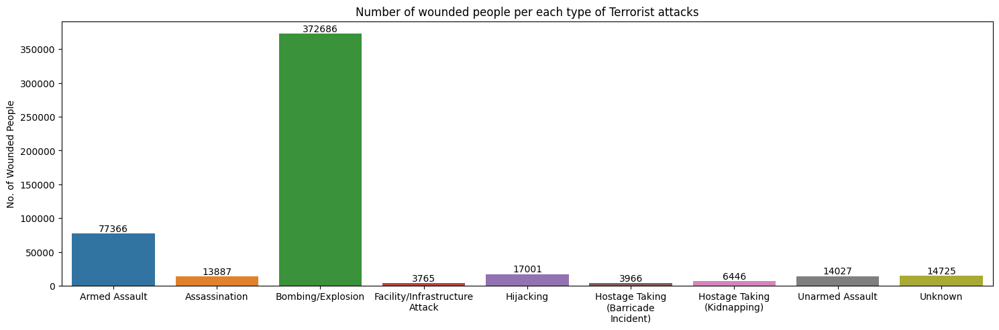

In [19]:
df_attacktype = df.groupby('attacktype1_txt')[['nwound']].sum().reset_index()
fig, ax = plt.subplots(figsize=(15,5))
sns.barplot(
    data=df_attacktype,
    x="attacktype1_txt",
    y="nwound",
)
wrap_labels(ax,18)
for i in ax.containers:
    ax.bar_label(i,)
plt.tight_layout()
plt.xlabel(None)
plt.ylabel("No. of Wounded People")
plt.title("Number of wounded people per each type of Terrorist attacks");

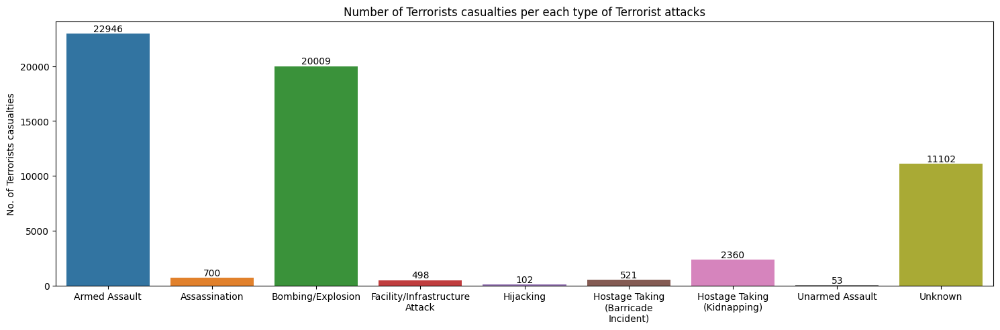

In [20]:
df_attacktype = df.groupby('attacktype1_txt')[['nkillter']].sum().reset_index()
fig, ax = plt.subplots(figsize=(15,5))
sns.barplot(
    data=df_attacktype,
    x="attacktype1_txt",
    y="nkillter",
)
wrap_labels(ax, 18)
for i in ax.containers:
    ax.bar_label(i,)
plt.tight_layout()
plt.xlabel(None)
plt.ylabel("No. of Terrorists casualties")
plt.title("Number of Terrorists casualties per each type of Terrorist attacks");